# A Directory of Visualisations

In [12]:
import os
from dotenv import load_dotenv, find_dotenv

import datetime
import numpy as np
from  scipy.stats import gaussian_kde
import pandas as pd
from matplotlib import pyplot as plt
import matplotlib as mpl

import squarify

from statsmodels.graphics.mosaicplot import mosaic

from sankeyflow import Sankey

import networkx as nx

In [13]:
# makes the inline-figures in notebooks look crisper
%config InlineBackend.figure_format = 'svg'

In [14]:
load_dotenv(find_dotenv(usecwd=True));

In [15]:
data_folder=os.getenv('DATA_FOLDER')

In [16]:
greys = [mpl.colormaps['tab20c_r'](i) for i in range(4)]
greys;

In [17]:
def theme_icon_plot(ax, x_visible=False, y_visible=False, title=''):
    ax.set_title(title)
    ax.spines[:].set_visible(False)
    
    ax.set_xticks([])
    ax.set_yticks([])
    
    ax.legend([],[], frameon=False)
    ax.set_xlabel("")
    ax.set_ylabel("")
    
    
    if x_visible: 
        ax.spines['bottom'].set_visible(True)
        #ax.xaxis.set_major_locator(mpl.ticker.AutoLocator())
        ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(4)) 
        ax.set(xticklabels=[])
        # ax.set_xticks(major_ticks)
    
    if y_visible:
        ax.spines['left'].set_visible(True)
        
        # ax.yaxis.set_major_locator(mpl.ticker.AutoLocator())
        ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(4))
        ax.set(yticklabels=[])
        
    return ax

In [18]:
icon_edge_length=3

# Visualising numerical values

## Bars and dots

In [19]:
df_one_amount = pd.DataFrame({'x': [0.6]})

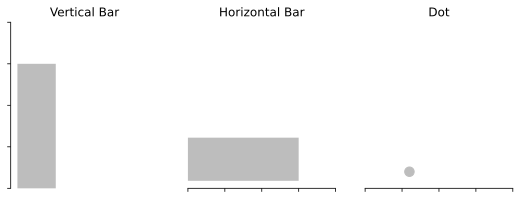

In [20]:
#| label: bars_dot
#| echo: false
#| fig-cap: "Bars (vertical or horizontal) and dots to visualise amounts."

n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

axs[0].set_ylim([0,1.0])
axs[0].bar([1, 2, 3], [0.75, 0, 0], facecolor=greys[1])
theme_icon_plot(axs[0], x_visible=False, y_visible=True, title='Vertical Bar')

axs[1].set_xlim([0,1.0])
axs[1].barh([1, 2, 3], [0.75, 0, 0], facecolor=greys[1])
theme_icon_plot(axs[1], x_visible=True, y_visible=False, title='Horizontal Bar')

axs[2].set_xlim([0,1.0])
axs[2].set_ylim([0,1.0])
axs[2].scatter([0.3], [0.1], facecolor=greys[1], s=90)
theme_icon_plot(axs[2], x_visible=True, y_visible=False, title='Dot')

plt.show()

## Distributions of continuous variables

In [21]:
rng = np.random.default_rng(seed=5142)

df_one_dist = pd.DataFrame({'x': np.concatenate((rng.normal(1., 1.6, 1000), rng.normal(4, .4, 300)), axis=0)})
df_one_dist;

ValueError: Invalid RGBA argument: np.float64(0.7411764705882353)

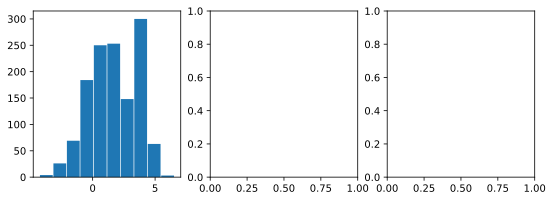

In [22]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

axs[0].hist(df_one_dist, bins=10, rwidth=0.95, facecolor=greys[1])
theme_icon_plot(axs[0], x_visible=True, y_visible=True, title='Histogram')

x = np.linspace(df_one_dist['x'].min(), df_one_dist['x'].max())
y = gaussian_kde(df_one_dist['x'])(x)
axs[1].plot(x,y/y.max(), color=greys[3])
axs[1].fill_between(x, y/y.max(), color=greys[1])

theme_icon_plot(axs[1], x_visible=True, y_visible=True, title='Density')

axs[2].hist(df_one_dist, bins=30, density=True, histtype='step',cumulative=True, color=greys[3])
axs[2].set_xlim([0,6.1])
theme_icon_plot(axs[2], x_visible=True, y_visible=True, title='Cumulative Density')

plt.show()

##  {#slide3-id data-menu-title="Box and violin plots"}

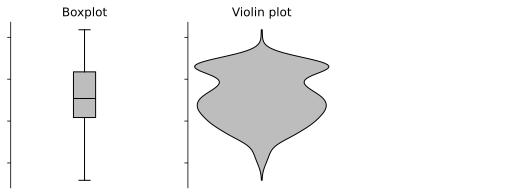

In [84]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))
bplot = axs[0].boxplot(df_one_dist, patch_artist=True, medianprops={'color':'black'}) 
bplot['boxes'][0].set_facecolor(greys[1])
theme_icon_plot(axs[0], x_visible=False, y_visible=True, title='Boxplot')

vplot = axs[1].violinplot(df_one_dist, showextrema=False)
vplot['bodies'][0].set_facecolor(greys[1])
vplot['bodies'][0].set_alpha(1)
vplot['bodies'][0].set_edgecolor('black')

theme_icon_plot(axs[1], x_visible=False, y_visible=True, title='Violin plot')

theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)

plt.show()

## Relationship of 2 variables<br>(ordinal scale or higher){.smaller}

In [85]:
rng = np.random.default_rng(seed=5142)

n=15
x = rng.standard_normal(n)
y = 0.4 * x + 0.6 * rng.standard_normal(n)
df_scatter_xy = pd.DataFrame({'x': x, 'y': y})
df_scatter_xy['s'] = [2.0]*len(x)
df_scatter_xy;

In [86]:
rng = np.random.default_rng(seed=5142)

n=8
x = rng.standard_normal(n)
y = 0.4 * x + 0.6 * rng.standard_normal(n)
s = 6.0*x + 0.3* rng.standard_normal(n)
s = (s - np.min(s) + 2.1)**2

df_scatter_xys = pd.DataFrame({'x': x, 'y': y, 's':s})
df_scatter_xys;

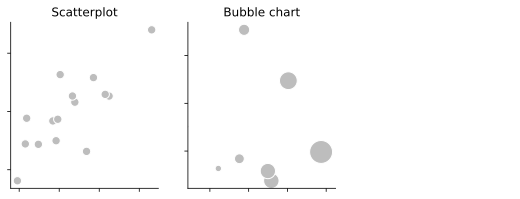

In [87]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

axs[0].scatter(x='x', y='y', s=70.0, color=greys[1], edgecolor='white', data=df_scatter_xy)
theme_icon_plot(axs[0], x_visible=True, y_visible=True, title='Scatterplot')

axs[1].scatter(x='x', y='y', s='s', color=greys[1], edgecolor='white', data=df_scatter_xys)
axs[1].set_xlim([df_scatter_xys['x'].min(),df_scatter_xys['x'].max()*1.2])
theme_icon_plot(axs[1], x_visible=True, y_visible=True, title='Bubble chart')

theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)

plt.show()

Scatterplots visualise the relationship between two variables at least at an ordinal scale.<br>A third variable can be mapped onto the dot size leading to a bubble chart.

## Relationship of 2 continuous variables

In [88]:
# 2 dense point clouds next to each other
rng = np.random.default_rng(seed=5142)

n=100
x1 = rng.normal(loc=0.0, scale=0.7, size=300)

x2 = rng.normal(loc=2, scale=0.2, size=160)
y1 = 2 * x1 +rng.normal(loc=0.5, scale=1.6, size=300)
y2 = 1.5 * x2 + rng.normal(loc=0.5, scale=1.6, size=160)

df_dense_xy = pd.DataFrame({'x': np.concatenate([x1,x2]), 'y': np.concatenate([y1,y2])})
df_dense_xy;

In [89]:
# KDE on the point clouds
nbins=300
k = gaussian_kde([df_dense_xy['x'], df_dense_xy['y']])
xi, yi = np.mgrid[df_dense_xy['x'].min():df_dense_xy['x'].max()*1.4:nbins*1j, df_dense_xy['y'].min():df_dense_xy['y'].max()*1.4:nbins*1j]
zi = k(np.vstack([xi.flatten(), yi.flatten()]))

In [91]:
n_cols = 4
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

axs[0].pcolormesh(xi, yi, zi.reshape(xi.shape), cmap='Greys', shading='auto')
theme_icon_plot(axs[0], x_visible=True, y_visible=True, title='2D-density plot')

axs[1].contour(xi, yi, zi.reshape(xi.shape), colors='black')
theme_icon_plot(axs[1], x_visible=True, y_visible=True, title='contour plot')

axs[2].hist2d(df_dense_xy['x'], df_dense_xy['y'], bins=(15, 15), cmap='Greys')
axs[2].set_xlim([df_dense_xy['x'].min(), df_dense_xy['x'].max()*1.4])
axs[2].set_ylim([df_dense_xy['y'].min(), df_dense_xy['y'].max()*1.4])
theme_icon_plot(axs[2], x_visible=True, y_visible=True, title='2D-histogram')

axs[3].hexbin(df_dense_xy['x'], df_dense_xy['y'], gridsize=15, cmap='Greys')
axs[3].set_xlim([df_dense_xy['x'].min(), df_dense_xy['x'].max()*1.4])
axs[3].set_ylim([df_dense_xy['y'].min(), df_dense_xy['y'].max()*1.4])
theme_icon_plot(axs[3], x_visible=True, y_visible=True, title='Hex bins')

plt.show()

## Line graphs

In [92]:
df_one_line = pd.DataFrame({'x': [1,2,3,4,5], 'y': [3.1, 3.3, 4.0, 3.8, 4.4]})

df_connected_line = pd.DataFrame({'x': [1,2,3,3.8,3.4, 2.5, 1.5, 2.1], 'y': [5.1, 5.5, 5.4, 4.9, 4.5, 4.2, 4.6, 4.9]})

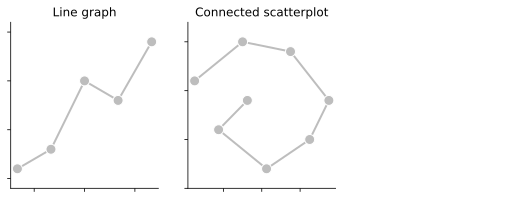

In [93]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

axs[0].set_ylim([2.9,4.6])
axs[0].plot(df_one_line['x'], df_one_line['y'], color=greys[1], marker='o', markersize=10, markeredgecolor='white',
            linestyle='-', linewidth=2) 
theme_icon_plot(axs[0], x_visible=True, y_visible=True, title='Line graph')

axs[1].set_ylim([4.0,5.7])
axs[1].plot(df_connected_line['x'], df_connected_line['y'], color=greys[1], marker='o', markersize=10,
            markeredgecolor='white', linestyle='-', linewidth=2)
theme_icon_plot(axs[1], x_visible=True, y_visible=True, title='Connected scatterplot')

theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)

plt.show()

## Relationships between multiple numerical variables

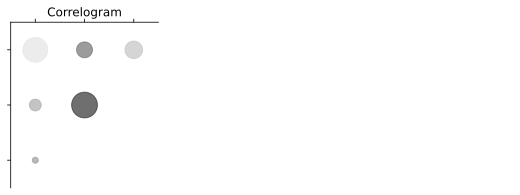

In [94]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))


# Generate some example data
np.random.seed(42)
data = pd.DataFrame(np.random.rand(4, 4), columns=[f'Var{i}' for i in range(1, 5)])

# Calculate the correlation matrix
correlation_matrix = data.corr()

# Get variable names
variables = correlation_matrix.columns

size_multiplier = 1000

norm = plt.Normalize(-1, 1)

# Create scatter plot with circles
for i in range(len(variables)):
    for j in range(i+1, len(variables)):
        x = correlation_matrix.index.get_loc(variables[i]) + 0.5
        y = correlation_matrix.index.get_loc(variables[j]) + 0.5
        size = np.abs(correlation_matrix.iloc[i, j]) * size_multiplier  # Adjust the size multiplier as needed
        color = mpl.colormaps['Greys'](norm(correlation_matrix.iloc[i, j]))
        axs[0].scatter(x, y, s=size, color=color, alpha=0.7, edgecolors=None)

axs[0].set_xlim([0,3])
axs[0].set_ylim([1,4])

axs[0].set_title('Correlogram')
axs[0].spines[:].set_visible(False)
axs[0].spines['top'].set_visible(True)
axs[0].spines['left'].set_visible(True)
    
axs[0].set_xticks([0.5,1.5,2.5])
axs[0].set_yticks([1.5,2.5, 3.5])
axs[0].tick_params(top=True, labeltop=False, bottom=False, labelbottom=False,
                   left=True, labelleft=False)
    

axs[0].set_xlabel("")
axs[0].set_ylabel("")

# theme_icon_plot(axs[0], x_visible=False, y_visible=True, title=)
theme_icon_plot(axs[1], x_visible=False, y_visible=False, title=None)
theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)

# Show the plot
plt.show()

# Relations continuous - discrete

## {#slide4-id data-menu-title="Slopegraph"}

In [95]:
df_slope_graph = pd.DataFrame({'element': [1,1,2,2,3,3,4,4,5,5], 'observation': [1,2,1,2,1,2,1,2,1,2], 'value': [0.2,0.3,0.31,0.35,0.5,0.6,0.7,0.72,0.75,0.51]})
df_slope_graph;

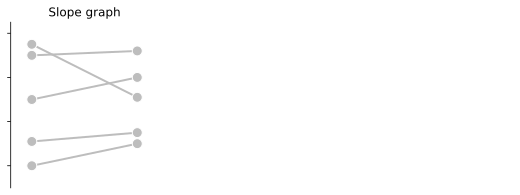

In [96]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

for element in df_slope_graph['element'].unique():
    df_tmp = df_slope_graph[df_slope_graph['element'] == element]
    axs[0].plot(df_tmp['observation'], df_tmp['value'], color=greys[1], marker='o', markersize=10,
            markeredgecolor='white', linestyle='-', linewidth=2)

axs[0].set_ylim([0.1, 0.85])
axs[0].set_xlim([0.8, 2.2])
theme_icon_plot(axs[0], x_visible=False, y_visible=True, title='Slope graph')

theme_icon_plot(axs[1], x_visible=False, y_visible=False, title=None)

theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)

plt.show()

## Bar charts

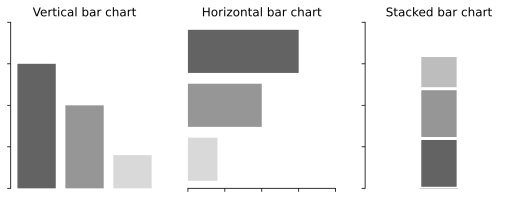

In [97]:
icon_edge_length=3

n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))


axs[0].set_ylim([0,1.0])
axs[0].bar([1, 2, 3], [0.75, 0.0, .0], facecolor=greys[3])
axs[0].bar([1, 2, 3], [0.0, 0.5, .0], facecolor=greys[2])
axs[0].bar([1, 2, 3], [0.0, 0.0, .2], facecolor=greys[0])
theme_icon_plot(axs[0], x_visible=False, y_visible=True, title='Vertical bar chart')

axs[1].set_xlim([0,1.0])
axs[1].barh([1, 2, 3], [0.2, 0.0, 0.0], facecolor=greys[0])
axs[1].barh([1, 2, 3], [0.0, 0.5, 0], facecolor=greys[2])
axs[1].barh([1, 2, 3], [0.0, 0, 0.75], facecolor=greys[3])
theme_icon_plot(axs[1], x_visible=True, y_visible=False, title='Horizontal bar chart')


axs[2].set_ylim([0,1.0])
axs[2].bar([1, 2, 3], [0.0, 0.8, .0], edgecolor='white', linewidth=3, facecolor=greys[1])
axs[2].bar([1, 2, 3], [0.0, 0.6, .0], edgecolor='white', linewidth=3, facecolor=greys[2])
axs[2].bar([1, 2, 3], [0.0, 0.3, .0], edgecolor='white', linewidth=3, facecolor=greys[3])

theme_icon_plot(axs[2], x_visible=False, y_visible=True, title='Stacked bar chart')

plt.show()

## Visualising proportions

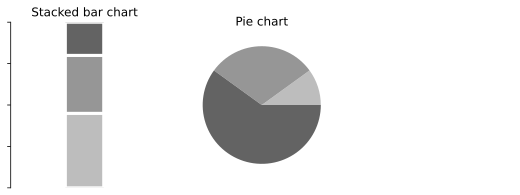

In [98]:
icon_edge_length=3

n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

axs[0].set_ylim([0,1.0])
axs[0].bar([1, 2, 3], [0.0, 0.45, .0],  edgecolor='white', linewidth=3, facecolor=greys[1])
axs[0].bar([1, 2, 3], [0.0, 0.35, .0], bottom=0.45, edgecolor='white', linewidth=3, facecolor=greys[2])
axs[0].bar([1, 2, 3], [0.0, 0.2, .0], bottom=0.35+0.45, edgecolor='white', linewidth=3, facecolor=greys[3])
theme_icon_plot(axs[0], x_visible=False, y_visible=True, title='Stacked bar chart')

axs[1].pie([0.1, 0.3, 0.6], colors=greys[1:])
theme_icon_plot(axs[1], x_visible=False, y_visible=False, title='Pie chart')

theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)
plt.show()

To show proportions that add up to 100 % along the continuous dimension

## Nested proportions

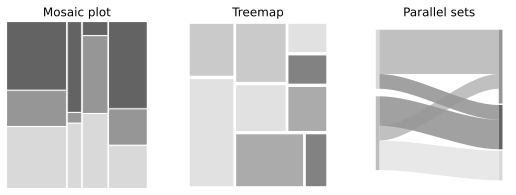

In [20]:
icon_edge_length=3

n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))
# Adjust the space between subplots to make the plot areas the same size
fig.subplots_adjust(wspace=0.3, hspace=0.3)

rng = np.random.default_rng(seed=42)
from itertools import product
tuples = list(product(['bar', 'baz', 'foo', 'qux'], ['one', 'two', 'three']))
index = pd.MultiIndex.from_tuples(tuples, names=['first', 'second'])
data = pd.Series(rng.random(12), index=index)

data['bar'] *= 2.0
data['baz'] *= 0.5
data['foo'] *= 1.0
data['qux'] *= 1.5 

props = lambda key: {'color': greys[0] if 'one' in key else (greys[2] if 'two' in key else greys[3])}
labelizer = lambda k: ''

mosaic_plot = mosaic(data, ax=axs[0], labelizer=labelizer, properties=props, gap=0.02, title=None)

theme_icon_plot(axs[0], x_visible=False, y_visible=False, title='Mosaic plot')

# Remove the frame around the mosaic plot
for ax in mosaic_plot[0].get_axes():
    # ax = ax_tuple[0]
    for spine in ax.spines.values():
        spine.set_visible(False)

values = [8,4,6,2, 4, 5, 3, 2,2]
groups = [str(i) for i in range(len(values))]
df_tree = pd.DataFrame({'values':values, 'group':groups })
# plot it
squarify.plot(sizes=df_tree['values'], label=None, alpha=.8, pad=True, color=greys, ax=axs[1])
theme_icon_plot(axs[1], x_visible=False, y_visible=False, title='Treemap')


nodes = [
    [('1', 4), ('2', 5)],
    [('3', 5), ('5', 3), ('6', 2)]
]
flows = [
    ('1', '3', 3),
    ('1', '5', 1),
    ('2', '5', 2),
    ('2', '3', 1),
    ('2', '6', 2),
    
]

s = Sankey(
    ax=axs[2],
    flows=flows,
    nodes=nodes,
    cmap=mpl.colors.ListedColormap(greys), # mpl.cm.get_cmap('tab20c_r'),
    flow_color_mode='dest',
    node_opts=dict(label_format=None)
)
s.draw(ax=axs[2])

theme_icon_plot(axs[2], x_visible=False, y_visible=False, title='Parallel sets')

plt.show()


## Intersections of independent sets

In [100]:
import matplotlib_venn as mpl_venn

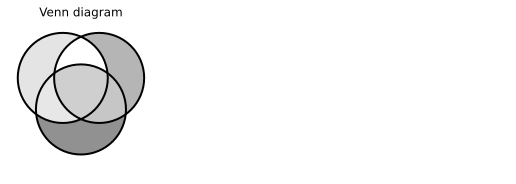

In [101]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))
 
# depict venn diagram 
venn_diagram =mpl_venn.venn3(subsets=(1, 1, 1, 1, 1, 1, 1),  
      set_labels=('', '', ''),  
      set_colors=(greys[0], greys[2], greys[3]), alpha=0.7,
      ax=axs[0]) 
  
# outline of circle line style and width 
mpl_venn.venn3_circles(subsets=(1, 1, 1, 1, 1, 1, 1), 
             linestyle="solid", linewidth=2, ax=axs[0]) 

# Customize labels
for label_id in ['100', '010', '001', '110', '101', '011', '111']:
    venn_diagram.get_label_by_id(label_id).set_text('')

theme_icon_plot(axs[0], x_visible=False, y_visible=False, title='Venn diagram')

theme_icon_plot(axs[1], x_visible=False, y_visible=False, title=None)
theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)
 
plt.show() 

## 1 Continuous - 2 discrete variables

In [102]:
pies = [[0.1, 0.3, 0.6], [0.6, 0.2, 0.2], [0.3, 0.4, 0.3]]

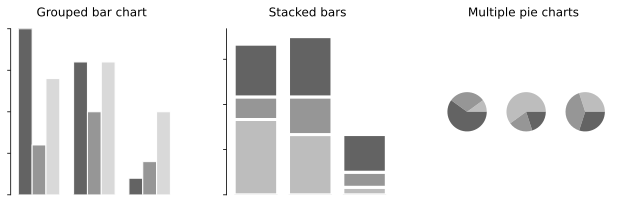

In [103]:
n_cols = 3
n_rows = 1

fig = plt.figure(figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

subfigs = fig.subfigures(1, 3, width_ratios=[1,1,1])

# set width of bars
barWidth = 0.25
 
# set heights of bars
bars1 = np.array([1, 0.8, 0.1])
bars2 = np.array([0.3, 0.5, 0.2])
bars3 = np.array([0.7, 0.8, 0.5])
 
# Set position of bar on X axis
r1 = np.arange(len(bars1))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]
 
subfigs[0].suptitle('Grouped bar chart')
ax_subfig0 = subfigs[0].subplots(1, 1)

ax_subfig0.set_ylim([0,1.0])
ax_subfig0.bar(r1, bars1, color=greys[3], width=barWidth, edgecolor='white', label='var1')
ax_subfig0.bar(r2, bars2, color=greys[2], width=barWidth, edgecolor='white', label='var2')
ax_subfig0.bar(r3, bars3, color=greys[0], width=barWidth, edgecolor='white', label='var3')
theme_icon_plot(ax_subfig0, x_visible=False, y_visible=True, title=None)

subfigs[1].suptitle('Stacked bars')
ax_subfig1 = subfigs[1].subplots(1, 1)

# ax_subfig1.set_ylim([0,1.0])
ax_subfig1.bar([1, 2, 3], bars1, edgecolor='white', linewidth=3, facecolor=greys[1])
ax_subfig1.bar([1, 2, 3], bars2, bottom=bars1, edgecolor='white', linewidth=3, facecolor=greys[2])
ax_subfig1.bar([1, 2, 3], bars3, bottom=bars1+bars2, edgecolor='white', linewidth=3, facecolor=greys[3])
theme_icon_plot(ax_subfig1, x_visible=False, y_visible=True, title=None)

subfigs[2].suptitle('Multiple pie charts')
axs_subfig2 = subfigs[2].subplots(1, len(pies)) # , figsize =(n_cols*icon_edge_length/3, n_rows * icon_edge_length) 

for i, fracs in enumerate(pies):
    axs_subfig2[i].pie(fracs, colors=greys[1:])
    theme_icon_plot(axs_subfig2[i], x_visible=False, y_visible=False, title=None)


plt.show()

## {#slide5-id data-menu-title="Heatmap"}

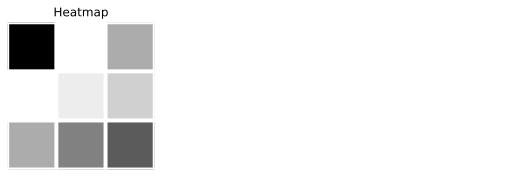

In [104]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

data_heatmap = np.array([[0.8, 0.1, 0.4], [0.1, 0.2, 0.3], [0.4, 0.5, 0.6]])
im = axs[0].imshow(data_heatmap, cmap='Greys')

axs[0].set_xticks([])
axs[0].set_yticks([])

axs[0].set_xticks(np.arange(data_heatmap.shape[1]+1)-.5, minor=True)
axs[0].set_yticks(np.arange(data_heatmap.shape[0]+1)-.5, minor=True)
axs[0].grid(which="minor", color="w", linestyle='-', linewidth=4)
axs[0].tick_params(which="minor", bottom=False, left=False)

axs[0].legend([],[], frameon=False)
axs[0].set_xlabel("")
axs[0].set_ylabel("")
axs[0].set(xticklabels=[], yticklabels=[])

theme_icon_plot(axs[0], x_visible=False, y_visible=False, title='Heatmap')


theme_icon_plot(axs[1], x_visible=False, y_visible=False, title=None)

theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)

plt.show()

/Users/doem/anaconda3/envs/vdss/lib/python3.10/site-packages/networkx/drawing/nx_pylab.py:437: UserWarning: *c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2D array with a single row if you intend to specify the same RGB or RGBA value for all points.
  node_collection = ax.scatter(


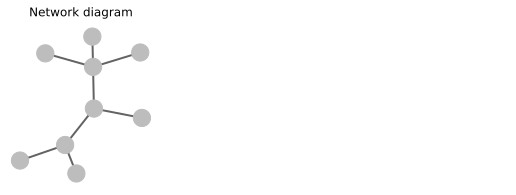

In [107]:
n_cols = 3
n_rows = 1

fig, axs = plt.subplots(n_rows, n_cols, figsize =(n_cols*icon_edge_length, n_rows * icon_edge_length))

# Build a dataframe with your connections
df = pd.DataFrame({ 'from':['A', 'B', 'A','A','B','C','C','C'], 
                      'to':['B', 'C', 'D','E','F','G','H','I']})
 
# Build your graph
G=nx.from_pandas_edgelist(df, 'from', 'to')
 
# Fruchterman Reingold
nx.draw(G, with_labels=False, node_size=300, width=2.0, edge_color=greys[3], node_color=greys[1],
        pos=nx.fruchterman_reingold_layout(G, seed=2), ax=axs[0])

theme_icon_plot(axs[0], x_visible=False, y_visible=False, title='Network diagram')

theme_icon_plot(axs[1], x_visible=False, y_visible=False, title=None)

theme_icon_plot(axs[2], x_visible=False, y_visible=False, title=None)

plt.show()

# Navigating the directory of visualisations
## From Data to Viz
A decision tree for visualisations:
[www.data-to-viz.com](https://www.data-to-viz.com/){preview-link="true"}